<a href="https://colab.research.google.com/github/jtndr26/Bank_Loan_Applications/blob/main/Banking_Loan_Application_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## EDA Group Case Study

#### Problem Statement:
-  Use EDA to analyse the patterns present in the data. This will ensure that the applicants capable of repaying the loan are not rejected.
-  Present the overall approach of the analysis in a presentation. Mention the problem statement and the analysis approach briefly.
-  Identify the missing data and use appropriate method to deal with it.
-  Explain the results of univariate, segmented univariate, bivariate analysis, etc. in business terms.
-  Find the top 10 correlation for the Client with payment difficulties and all other cases (Target variable).
-  Include visualisations and summarise the most important results in the presentation. Insights should explain why the variable is important for differentiating the clients with payment difficulties with all other cases.

### Github Link:
https://github.com/jtndr26/Bank_Loan_Applications


In [ ]:
#importing required packages
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt, seaborn as sns
%matplotlib inline

In [ ]:
# Mounting drive to read file from Google drive.
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#Loading Application Dataset to pandas variable
appl_data = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/EDA/EDA+Banking+Loan+Application/application_data.csv',encoding = 'ISO-8859-1')

# Application Dataset

In [ ]:
pd.set_option("display.max_columns", 200)
pd.set_option("display.max_rows", None)
appl_data.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [ ]:
appl_data.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,104582.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307509.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,134133.000000,3.068510e+05,246546.000000,151450.00000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,159080.000000,306490.000000,306490.000000,306490.000000,306490.000000,307510.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.00000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,-4986.120328,-2994.202373,12.061091,0.999997,0.819889,0.199368,0.998133,0.281066,0.056720,2.152665,2.052463,2.031521,12.063419,0.015144,0.050769,0.040659,0.078173,0.230454,0.179555,0.502130,5.143927e-01,0.510853,0.11744,0.088442,0.977735,0.752471,0.044621,0.078942,0.149725,0.226282,0.231894,0.066333,0.100775,0.107399,0.008809,0.028358,0.114231,0.087543,0.977065,0.759637,0.042553,0.074490,0.145193,0.222315,0.228058,0.064958,0.105645,0.105975,0.008076,0.027022,0.117850,0.087955,0.97

In [ ]:
appl_data.shape

(307511, 122)

#### Cleaning the Data: Application Dataset

In [ ]:
#Checking for More than 40% Null Values
application_null_columns = appl_data.isnull().mean().round(4) * 100
application_null_columns[application_null_columns>=40.00]

OWN_CAR_AGE                     65.99
EXT_SOURCE_1                    56.38
APARTMENTS_AVG                  50.75
BASEMENTAREA_AVG                58.52
YEARS_BEGINEXPLUATATION_AVG     48.78
YEARS_BUILD_AVG                 66.50
COMMONAREA_AVG                  69.87
ELEVATORS_AVG                   53.30
ENTRANCES_AVG                   50.35
FLOORSMAX_AVG                   49.76
FLOORSMIN_AVG                   67.85
LANDAREA_AVG                    59.38
LIVINGAPARTMENTS_AVG            68.35
LIVINGAREA_AVG                  50.19
NONLIVINGAPARTMENTS_AVG         69.43
NONLIVINGAREA_AVG               55.18
APARTMENTS_MODE                 50.75
BASEMENTAREA_MODE               58.52
YEARS_BEGINEXPLUATATION_MODE    48.78
YEARS_BUILD_MODE                66.50
COMMONAREA_MODE                 69.87
ELEVATORS_MODE                  53.30
ENTRANCES_MODE                  50.35
FLOORSMAX_MODE                  49.76
FLOORSMIN_MODE                  67.85
LANDAREA_MODE                   59.38
LIVINGAPARTM

There are null values more than 40% in columns related to apartment. Certain variables like apartment area in a high density region can give some insights to living conditions of the person. We can keep the APARTMENTS_AVG and drop rest.

In [ ]:
droppable_cols = appl_data.loc[:,'BASEMENTAREA_AVG':'EMERGENCYSTATE_MODE'].columns
appl_data.drop(droppable_cols, inplace=True, axis=1)
appl_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 76 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   SK_ID_CURR                   307511 non-null  int64  
 1   TARGET                       307511 non-null  int64  
 2   NAME_CONTRACT_TYPE           307511 non-null  object 
 3   CODE_GENDER                  307511 non-null  object 
 4   FLAG_OWN_CAR                 307511 non-null  object 
 5   FLAG_OWN_REALTY              307511 non-null  object 
 6   CNT_CHILDREN                 307511 non-null  int64  
 7   AMT_INCOME_TOTAL             307511 non-null  float64
 8   AMT_CREDIT                   307511 non-null  float64
 9   AMT_ANNUITY                  307499 non-null  float64
 10  AMT_GOODS_PRICE              307233 non-null  float64
 11  NAME_TYPE_SUITE              306219 non-null  object 
 12  NAME_INCOME_TYPE             307511 non-null  object 
 13 

Document flags also does not have much relevance in our analysis, since they are normally precursor to any loan application and banks dont go further without these. Moreover we dont have enough information in what these documents are. So we can drop those as well.

In [ ]:
droppable_cols = appl_data.loc[:,'FLAG_DOCUMENT_2':'FLAG_DOCUMENT_21'].columns
appl_data.drop(droppable_cols, inplace=True, axis=1)
appl_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 56 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   SK_ID_CURR                   307511 non-null  int64  
 1   TARGET                       307511 non-null  int64  
 2   NAME_CONTRACT_TYPE           307511 non-null  object 
 3   CODE_GENDER                  307511 non-null  object 
 4   FLAG_OWN_CAR                 307511 non-null  object 
 5   FLAG_OWN_REALTY              307511 non-null  object 
 6   CNT_CHILDREN                 307511 non-null  int64  
 7   AMT_INCOME_TOTAL             307511 non-null  float64
 8   AMT_CREDIT                   307511 non-null  float64
 9   AMT_ANNUITY                  307499 non-null  float64
 10  AMT_GOODS_PRICE              307233 non-null  float64
 11  NAME_TYPE_SUITE              306219 non-null  object 
 12  NAME_INCOME_TYPE             307511 non-null  object 
 13 

### Handeling Missing Values

In [ ]:
#Columns with Missing Values
application_null_columns = appl_data.isnull().mean().round(4) * 100
application_null_columns[application_null_columns>0.00]

AMT_GOODS_PRICE                0.09
NAME_TYPE_SUITE                0.42
OWN_CAR_AGE                   65.99
OCCUPATION_TYPE               31.35
EXT_SOURCE_1                  56.38
EXT_SOURCE_2                   0.21
EXT_SOURCE_3                  19.83
APARTMENTS_AVG                50.75
OBS_30_CNT_SOCIAL_CIRCLE       0.33
DEF_30_CNT_SOCIAL_CIRCLE       0.33
OBS_60_CNT_SOCIAL_CIRCLE       0.33
DEF_60_CNT_SOCIAL_CIRCLE       0.33
AMT_REQ_CREDIT_BUREAU_HOUR    13.50
AMT_REQ_CREDIT_BUREAU_DAY     13.50
AMT_REQ_CREDIT_BUREAU_WEEK    13.50
AMT_REQ_CREDIT_BUREAU_MON     13.50
AMT_REQ_CREDIT_BUREAU_QRT     13.50
AMT_REQ_CREDIT_BUREAU_YEAR    13.50
dtype: float64

Instead of having three columns for 'EXT_SOURCE' with significant amount of null values, we can maintain one single column providing average of all three

In [ ]:
appl_data['EXT_SOURCE'] = appl_data[['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3']].mean(axis=1)
droppable_cols = appl_data[['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3']].columns
appl_data.drop(droppable_cols, inplace=True, axis=1)
appl_data.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,APARTMENTS_AVG,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,EXT_SOURCE
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,104582.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307509.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,151450.00000,306490.000000,306490.000000,306490.000000,306490.000000,307510.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,307339.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,-4986.120328,-2994.202373,12.061091,0.999997,0.819889,0.199368,0.998133,0.281066,0.056720,2.152665,2.052463,2.031521,12.063419,0.015144,0.050769,0.040659,0.078173,0.230454,0.179555,0.11744,1.422245,0.143421,1.405292,0.100049,-962.858788,0.006402,0.007000,0.034362,0.267395,0.265474,1.899974,0.509251
std,102790.175348,0.272419,0.722121,2.371231e+05,4.024908e+05,14493.737315,3.694465e+05,0.013831,4363.988632,141275.766519,3522.886321,1509.450419,11.944812,0.001803,0.384280,0.399526,0.043164,0.449521,0.231307,0.910682,0.509034,0.502737,3.265832,0.122126,0.219526,0.197499,0.268444,0.421124,0.383817,0.10824,2.400989,0.446698,2.379803,0.362291,826.808487,0.083849,0.110757,0.204685,0.916002,0.794056,1.869295,0.149802
min,100002.000000,0.000000,0.000000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000290,-25229.000000,-17912.000000,-24672.000000,-7197.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,-4292.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000006
25%,189145.500000,0.000000,0.000000,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,0.010006,-19682.000000,-2760.000000,-7479.500000,-4299.000000,5.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,2.000000,2.000000,2.000000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.05770,0.000000,0.000000,0.000000,0.000000,-1570.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.413648
50%,278202.000000,0.000000,0.000000,1.471500e+05,5.135310e+05,24903.000000,4.500000e+05,0.018850,-15750.000000,-1213.000000,-4504.000000,-3254.000000,9.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,2.000000,2.000000,2.000000,12.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.08760,0.000000,0.000000,0.000000,0.000000,-757.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.524502
75%,367142.500000,0.000000,1.000000,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05,0.028663,-12413.000000,-289.000000,-2010.000000,-1720.000000,15.000000,1.000000,1.000000,0.000000,1.000000,1.000000,0.000000,3.000000,2.000000,2.000000,14.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.14850,2.000000,0.000000,2.000000,0.000000,-274.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000,0.622819
max,456255.000000,1.000000,19.000000,1.170000e+08,4.0500

### Handling Outliers

In [ ]:
appl_data.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,APARTMENTS_AVG,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,EXT_SOURCE
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,104582.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307509.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,151450.00000,306490.000000,306490.000000,306490.000000,306490.000000,307510.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,307339.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,-4986.120328,-2994.202373,12.061091,0.999997,0.819889,0.199368,0.998133,0.281066,0.056720,2.152665,2.052463,2.031521,12.063419,0.015144,0.050769,0.040659,0.078173,0.230454,0.179555,0.11744,1.422245,0.143421,1.405292,0.100049,-962.858788,0.006402,0.007000,0.034362,0.267395,0.265474,1.899974,0.509251
std,102790.175348,0.272419,0.722121,2.371231e+05,4.024908e+05,14493.737315,3.694465e+05,0.013831,4363.988632,141275.766519,3522.886321,1509.450419,11.944812,0.001803,0.384280,0.399526,0.043164,0.449521,0.231307,0.910682,0.509034,0.502737,3.265832,0.122126,0.219526,0.197499,0.268444,0.421124,0.383817,0.10824,2.400989,0.446698,2.379803,0.362291,826.808487,0.083849,0.110757,0.204685,0.916002,0.794056,1.869295,0.149802
min,100002.000000,0.000000,0.000000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000290,-25229.000000,-17912.000000,-24672.000000,-7197.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,-4292.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000006
25%,189145.500000,0.000000,0.000000,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,0.010006,-19682.000000,-2760.000000,-7479.500000,-4299.000000,5.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,2.000000,2.000000,2.000000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.05770,0.000000,0.000000,0.000000,0.000000,-1570.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.413648
50%,278202.000000,0.000000,0.000000,1.471500e+05,5.135310e+05,24903.000000,4.500000e+05,0.018850,-15750.000000,-1213.000000,-4504.000000,-3254.000000,9.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,2.000000,2.000000,2.000000,12.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.08760,0.000000,0.000000,0.000000,0.000000,-757.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.524502
75%,367142.500000,0.000000,1.000000,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05,0.028663,-12413.000000,-289.000000,-2010.000000,-1720.000000,15.000000,1.000000,1.000000,0.000000,1.000000,1.000000,0.000000,3.000000,2.000000,2.000000,14.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.14850,2.000000,0.000000,2.000000,0.000000,-274.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000,0.622819
max,456255.000000,1.000000,19.000000,1.170000e+08,4.0500

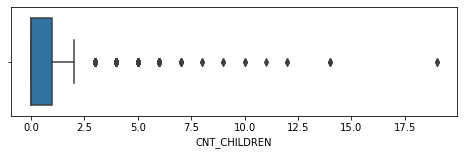

In [ ]:
#Analysing CNT_CHILDERN for outliers
plt.figure(figsize=[8,2])
sns.boxplot(appl_data.CNT_CHILDREN)
plt.show()

#### Capping the CNT_CHILDREN

In [ ]:
appl_data.CNT_CHILDREN.quantile(0.99)

3.0

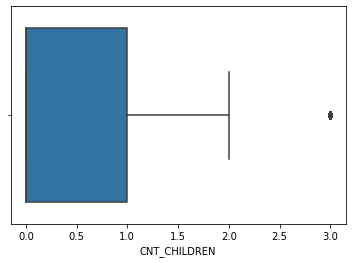

In [ ]:
#There are only 1% of the CNT_CHILDREN values greater than 3, replacing the outliers with value 3 so it doesn't
#hamper our analysis
appl_data.CNT_CHILDREN = np.where(appl_data.CNT_CHILDREN>3, 3, appl_data.CNT_CHILDREN)
sns.boxplot(appl_data.CNT_CHILDREN)
plt.show()

#### Removing problematic records from AMT_INCOME_TOTAL

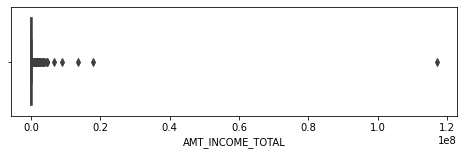

In [ ]:
#Analysing AMT_INCOME_TOTAL for outliers
plt.figure(figsize=[8,2])
sns.boxplot(appl_data.AMT_INCOME_TOTAL)
plt.show()

In [ ]:
appl_data.AMT_INCOME_TOTAL.quantile([.9, .95, 0.99, 0.999, 0.9999])

0.9000     270000.0
0.9500     337500.0
0.9900     472500.0
0.9990     900000.0
0.9999    2250000.0
Name: AMT_INCOME_TOTAL, dtype: float64

In [ ]:
# Getting records with unusually high values
appl_data[appl_data.AMT_INCOME_TOTAL > 20**6]

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,APARTMENTS_AVG,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,EXT_SOURCE
12840,114967,1,Cash loans,F,N,Y,1,117000000.0,562491.0,26194.5,454500.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.010643,-12615,-922,-6762.0,-3643,NaN,1,1,0,1,0,0,Laborers,3.0,2,2,TUESDAY,14,0,0,0,0,0,0,Business Entity Type 3,0.1031,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.239838


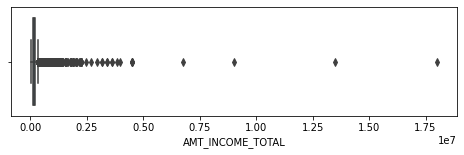

In [ ]:
# Dropping this record
appl_data = appl_data[~(appl_data.AMT_INCOME_TOTAL > 20**6)]
plt.figure(figsize=[8,2])
sns.boxplot(appl_data.AMT_INCOME_TOTAL)
plt.show()

There is no need to drop other records with high income values as they are continuous values normally spread even in case of outliers.

#### AMT_CREDIT column for outliers

In [ ]:
appl_data.AMT_CREDIT.describe()

count    3.075100e+05
mean     5.990261e+05
std      4.024914e+05
min      4.500000e+04
25%      2.700000e+05
50%      5.135310e+05
75%      8.086500e+05
max      4.050000e+06
Name: AMT_CREDIT, dtype: float64

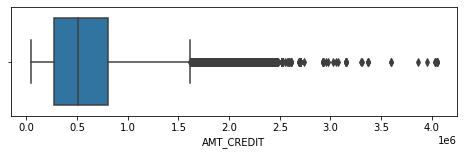

In [ ]:
plt.figure(figsize=[8,2])
sns.boxplot(appl_data.AMT_CREDIT)
plt.show()

In [ ]:
appl_data.AMT_CREDIT.quantile([.5, .7, .9, .95, 0.99])

0.50     513531.0
0.70     755190.0
0.90    1133748.0
0.95    1350000.0
0.99    1854000.0
Name: AMT_CREDIT, dtype: float64

In [ ]:
# Checking records which lies above the 99th percentile
appl_data[appl_data.AMT_CREDIT > 1854000]

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,APARTMENTS_AVG,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,EXT_SOURCE
189,100219,0,Cash loans,M,N,Y,1,315000.000,2250000.0,83515.5,2250000.0,Unaccompanied,Commercial associate,Higher education,Married,House / apartment,0.032561,-11177,-1514,-64.0,-2793,NaN,1,1,0,1,0,1,Core staff,3.0,1,1,FRIDAY,16,0,0,0,0,0,0,Business Entity Type 3,0.4753,0.0,0.0,0.0,0.0,-926.0,0.0,0.0,0.0,0.0,0.0,3.0,0.536725
337,100389,0,Cash loans,M,Y,Y,0,247500.000,1971072.0,68643.0,1800000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.006207,-14216,-365,-3183.0,-4423,13.0,1,1,1,1,0,0,Core staff,2.0,2,2,WEDNESDAY,14,0,0,0,0,0,0,Self-employed,0.2227,0.0,0.0,0.0,0.0,-2421.0,0.0,0.0,0.0,0.0,0.0,1.0,0.682066
341,100393,0,Cash loans,M,Y,Y,2,405000.000,2250000.0,59485.5,2250000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.007114,-14966,-6158,-954.0,-4979,6.0,1,1,0,1,1,0,Core staff,4.0,2,2,FRIDAY,13,0,0,0,0,0,0,Police,0.1763,0.0,0.0,0.0,0.0,-1014.0,0.0,0.0,0.0,0.0,0.0,1.0,0.687440
441,100508,0,Cash loans,F,Y,Y,0,450000.000,1971072.0,62019.0,1800000.0,"Spouse, partner",Commercial associate,Higher education,Married,House / apartment,0.032561,-18268,-2569,-4292.0,-1699,1.0,1,1,0,1,1,1,Managers,2.0,1,1,WEDNESDAY,13,0,0,0,0,0,0,Trade: type 3,0.1814,0.0,0.0,0.0,0.0,-523.0,0.0,0.0,0.0,0.0,4.0,1.0,0.621544
485,100559,0,Cash loans,F,Y,Y,0,450000.000,2286211.5,116266.5,2182500.0,Unaccompanied,State servant,Higher education,Married,House / apartment,0.018850,-20589,-13994,-5893.0,-4106,7.0,1,1,0,1,0,0,Core staff,2.0,2,2,MONDAY,16,0,0,0,0,0,0,Security Ministries,0.1485,1.0,0.0,1.0,0.0,-2675.0,NaN,NaN,NaN,NaN,NaN,NaN,0.503266
639,100730,0,Cash loans,F,N,Y,1,315000.000,1971072.0,62019.0,1800000.0,Unaccompanied,Commercial associate,Higher education,Married,House / apartment,0.032561,-16938,-1744,-3240.0,-496,NaN,1,1,0,1,0,0,Accountants,3.0,1,1,MONDAY,15,0,0,0,0,0,0,Business Entity Type 1,NaN,0.0,0.0,0.0,0.0,-696.0,0.0,0.0,0.0,0.0,0.0,2.0,0.755801
667,100771,0,Cash loans,M,N,Y,1,288000.000,1971072.0,68643.0,1800000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.020246,-17087,-5171,-1166.0,-518,NaN,1,1,0,1,1,1,Managers,3.0,3,3,TUESDAY,9,0,0,0,0,0,0,Industry: type 9,NaN,4.0,0.0,4.0,0.0,-1919.0,0.0,0.0,0.0,1.0,0.0,1.0,0.447769
678,100784,1,Cash loans,F,N,Y,0,54000.000,1885500.0,74191.5,1885500.0,Unaccompanied,Pensioner,Secondary / secondary special,Married,House / apartment,0.031329,-22181,365243,-14266.0,-4714,NaN,1,0,0,1,0,0,NaN,2.0,2,2,MONDAY,10,0,0,0,0,0,0,XNA,NaN,6.0,0.0,6.0,0.0,-1683.0,NaN,NaN,NaN,NaN,NaN,NaN,0.623843
748,100861,0,Cash loans,M,N,N,0,306000.000,2085120.0,72477.0,1800000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.035792,-14206,-5632,-185.0,-4669,NaN,1,1,0,1,0,0,Private service staff,2.0,2,2,FRIDAY,13,0,0,0,0,0,0,Other,0.0474,2.0,1.0,2.0,1.0,-931.0,0.0,0.0,0.0,1.0,0.0,4.0,0.434275
871,100999,0,Cash loans,M,Y,N,0,450000.000,2125953.0,81108.0,1984500.0,Unaccompanied,Commercial associate,Higher education,Single / not marr

The applications with relatively higer credits have GOODS price also very close to the credit, so it justifies. Thereby, no change here.

#### AMT_GOODS_PRICE column for outliers

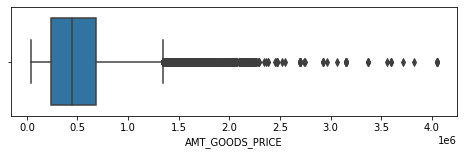

In [ ]:
plt.figure(figsize=[8,2])
sns.boxplot(appl_data.AMT_GOODS_PRICE)
plt.show()

This justifies credit distribution in real life, no change required.

#### DAYS_BIRTH column for outliers

In [ ]:
appl_data.DAYS_BIRTH.describe()

count    307510.000000
mean     -16037.006195
std        4363.991364
min      -25229.000000
25%      -19682.000000
50%      -15750.000000
75%      -12413.000000
max       -7489.000000
Name: DAYS_BIRTH, dtype: float64

### Standardizing the values

There are some columns like AGE and DAYS_EMPLOYED which is in days and can be more readable, so we convert those to the equivalent in years.

In [ ]:
# Adding a new column AGE to store age of applicant in years
appl_data['AGE'] = np.ceil(appl_data.DAYS_BIRTH / -365)
appl_data.AGE.describe()

count    307510.000000
mean         44.433121
std          11.954500
min          21.000000
25%          35.000000
50%          44.000000
75%          54.000000
max          70.000000
Name: AGE, dtype: float64

Nothing unusual here.

In [ ]:
# DAYS_EMPLOYED from Days to Years
appl_data['EXPERIENCE'] = np.round(appl_data.DAYS_EMPLOYED / -365, 1)
appl_data['EXPERIENCE']

0            1.7
1            3.3
2            0.6
3            8.3
4            8.3
5            4.4
6            8.6
7            1.2
8        -1000.7
9            5.5
10           1.9
11       -1000.7
12           7.4
13           8.3
14           0.6
15           3.2
16           3.6
17           0.5
18          21.4
19           5.6
20          11.7
21           4.5
22          11.8
23       -1000.7
24           2.0
25           9.6
26           7.2
27           3.4
28           4.9
29           2.8
30           7.3
31           3.0
32          12.1
33           5.6
34          12.6
35           3.5
36           2.1
37           3.5
38       -1000.7
39           4.8
40           3.5
41           1.3
42           9.9
43       -1000.7
44           2.1
45           2.5
46       -1000.7
47          14.6
48          12.1
49          26.1
50           3.2
51          19.1
52           2.1
53           3.8
54       -1000.7
55          11.2
56       -1000.7
57           6.4
58           4

In [ ]:
# Inspecting the negative experience
appl_data[appl_data['EXPERIENCE'] < 0].EXPERIENCE.value_counts()

-1000.7    55374
Name: EXPERIENCE, dtype: int64

Negative days are most likely because of no experience but can't be certain on this

In [ ]:
appl_data.loc[appl_data['EXPERIENCE'] < 0, 'EXPERIENCE'] = np.NaN
appl_data.loc[appl_data['EXPERIENCE'] < 0, 'EXPERIENCE'].value_counts()

Series([], Name: EXPERIENCE, dtype: int64)

In [ ]:
appl_data.NAME_FAMILY_STATUS.value_counts()

Married                 196431
Single / not married     45444
Civil marriage           29775
Separated                19770
Widow                    16088
Unknown                      2
Name: NAME_FAMILY_STATUS, dtype: int64

The Married and Civil Married Columns are same, so can be merged. Also there are 2 values which is Unknown, we will dropping them as they might hamper our analysis.

In [ ]:
# Convert value names
appl_data["NAME_FAMILY_STATUS"].replace({"Civil marriage": "Married", "Single / not married": "Single"}, inplace=True)

In [ ]:
# drop rows with status Unknown
appl_data = appl_data[~(appl_data.NAME_FAMILY_STATUS == 'Unknown')]
appl_data[(appl_data.NAME_FAMILY_STATUS == 'Unknown')]

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,APARTMENTS_AVG,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,EXT_SOURCE,AGE,EXPERIENCE


#### Gender column

In [ ]:
appl_data.CODE_GENDER.value_counts(normalize=True)*100

F      65.834385
M      34.164314
XNA     0.001301
Name: CODE_GENDER, dtype: float64

#### Loan contract type

In [ ]:
appl_data.NAME_CONTRACT_TYPE.value_counts()

Cash loans         278231
Revolving loans     29277
Name: NAME_CONTRACT_TYPE, dtype: int64

#### Combining Total Credit Searches into one single Column

In [ ]:
appl_data['Credit_Bureau_Total'] = appl_data.iloc[:,-9:-3].sum(axis=1)
appl_data.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,APARTMENTS_AVG,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,EXT_SOURCE,AGE,EXPERIENCE,Credit_Bureau_Total
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.0247,2.0,2.0,2.0,2.0,-1134.0,0.0,0.0,0.0,0.0,0.0,1.0,0.161787,26.0,1.7,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.0959,1.0,0.0,1.0,0.0,-828.0,0.0,0.0,0.0,0.0,0.0,0.0,0.466757,46.0,3.3,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.0,0.0,0.0,0.0,-815.0,0.0,0.0,0.0,0.0,0.0,0.0,0.642739,53.0,0.6,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.008019,-19005,-3039,-9833.0,-2437,NaN,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,NaN,2.0,0.0,2.0,0.0,-617.0,NaN,NaN,NaN,NaN,NaN,NaN,0.650442,53.0,8.3,0.0
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single,House / apartment,0.028663,-19932,-3038,-4311.0,-3458,NaN,1,1,0,1,0,0,Core staff,1.0,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,NaN,0.0,0.0,0.0,0.0,-1106.0,0.0,0.0,0.0,0.0,0.0,0.0,0.322738,55.0,8.3,0.0


# Previous Dataset

In [ ]:
previous_app = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/EDA/EDA+Banking+Loan+Application/previous_application.csv',encoding = 'ISO-8859-1')
previous_app.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
previous_app.shape

(1670214, 37)

In [ ]:
previous_app.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

In [ ]:
previous_app.isna().mean() * 100

SK_ID_PREV                      0.000000
SK_ID_CURR                      0.000000
NAME_CONTRACT_TYPE              0.000000
AMT_ANNUITY                    22.286665
AMT_APPLICATION                 0.000000
AMT_CREDIT                      0.000060
AMT_DOWN_PAYMENT               53.636480
AMT_GOODS_PRICE                23.081773
WEEKDAY_APPR_PROCESS_START      0.000000
HOUR_APPR_PROCESS_START         0.000000
FLAG_LAST_APPL_PER_CONTRACT     0.000000
NFLAG_LAST_APPL_IN_DAY          0.000000
RATE_DOWN_PAYMENT              53.636480
RATE_INTEREST_PRIMARY          99.643698
RATE_INTEREST_PRIVILEGED       99.643698
NAME_CASH_LOAN_PURPOSE          0.000000
NAME_CONTRACT_STATUS            0.000000
DAYS_DECISION                   0.000000
NAME_PAYMENT_TYPE               0.000000
CODE_REJECT_REASON              0.000000
NAME_TYPE_SUITE                49.119754
NAME_CLIENT_TYPE                0.000000
NAME_GOODS_CATEGORY             0.000000
NAME_PORTFOLIO                  0.000000
NAME_PRODUCT_TYP

In [ ]:
previous_app.NAME_CONTRACT_STATUS.value_counts(normalize=True)*100

Approved        62.074740
Canceled        18.938831
Refused         17.403638
Unused offer     1.582791
Name: NAME_CONTRACT_STATUS, dtype: float64

In [ ]:
previous_app.FLAG_LAST_APPL_PER_CONTRACT.value_counts(normalize=True)

Y    0.994926
N    0.005074
Name: FLAG_LAST_APPL_PER_CONTRACT, dtype: float64

In [ ]:
# Keeping only the last application
previous_app = previous_app[previous_app.FLAG_LAST_APPL_PER_CONTRACT == 'Y']
previous_app.FLAG_LAST_APPL_PER_CONTRACT.value_counts(normalize=True)

Y    1.0
Name: FLAG_LAST_APPL_PER_CONTRACT, dtype: float64

In [ ]:
previous_app.NFLAG_LAST_APPL_IN_DAY.value_counts(normalize=True)

1    0.999527
0    0.000473
Name: NFLAG_LAST_APPL_IN_DAY, dtype: float64

In [ ]:
# Assuming application with highest application id to be the last and dropping the remaining
previous_app = previous_app.sort_values('SK_ID_PREV', ascending=False).drop_duplicates('SK_ID_CURR')

In [ ]:
previous_app[previous_app.DAYS_TERMINATION > 0].head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
888701,2843497,451578,Cash loans,9175.185,132482.97,149969.97,NaN,132482.97,WEDNESDAY,11,Y,0,NaN,NaN,NaN,XNA,Approved,-618,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,24.0,middle,Cash Street: middle,365243.0,-588.0,102.0,365243.0,365243.0,1.0
1345642,2843496,425374,Revolving loans,31500.000,630000.00,630000.00,NaN,630000.00,THURSDAY,15,Y,1,NaN,NaN,NaN,XAP,Approved,-465,XNA,XAP,Unaccompanied,Repeater,XNA,Cards,x-sell,Credit and cash offices,-1,XNA,0.0,XNA,Card X-Sell,-454.0,-423.0,365243.0,365243.0,365243.0,0.0
298226,2843493,337804,Revolving loans,2250.000,45000.00,45000.00,NaN,45000.00,THURSDAY,17,Y,1,NaN,NaN,NaN,XAP,Approved,-459,XNA,XAP,Unaccompanied,Repeater,XNA,Cards,walk-in,Credit and cash offices,-1,XNA,0.0,XNA,Card Street,-438.0,-410.0,365243.0,365243.0,365243.0,0.0
1489940,2843491,107385,Cash loans,25421.985,841500.00,963684.00,NaN,841500.00,FRIDAY,12,Y,1,NaN,NaN,NaN,XNA,Approved,-304,Cash through the bank,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,60.0,low_action,Cash X-Sell: low,365243.0,-274.0,1496.0,365243.0,365243.0,1.0
728908,2843487,424008,Consumer loans,7179.795,78402.87,78399.00,3.87,78402.87,FRIDAY,15,Y,1,0.000054,NaN,NaN,XAP,Approved,-264,Cash through the bank,XAP,Unaccompanied,Repeater,Computers,POS,XNA,Country-wide,150,Consumer electronics,12.0,low_action,POS household without interest,365243.0,-233.0,97.0,365243.0,365243.0,0.0


In [ ]:
previous_app.shape

(338857, 37)

The columns relevan to us according to the target are SK_ID_CURR, AMT_CREDIT, NAME_CONTRACT_STATUS, CODE_REJECT_REASON, NAME_YIELD_GROUP and DAYS_TERMINATION. Dropping the rest

In [ ]:
previous_app1 = previous_app[['SK_ID_CURR', 'AMT_CREDIT', 'NAME_CONTRACT_STATUS', 'CODE_REJECT_REASON', 'NAME_YIELD_GROUP', 'DAYS_TERMINATION']]
previous_app1.head()

,SK_ID_CURR,AMT_CREDIT,NAME_CONTRACT_STATUS,CODE_REJECT_REASON,NAME_YIELD_GROUP,DAYS_TERMINATION
205485,406596,30912.75,Unused offer,CLIENT,XNA,NaN
717142,140761,41499.00,Unused offer,CLIENT,XNA,NaN
886179,237546,60673.50,Refused,LIMIT,middle,NaN
359118,100125,59503.50,Refused,SCO,middle,NaN
70058,250234,108180.00,Refused,SCO,low_action,NaN


#### Rename the column names in contect to current application

In [ ]:
names = {'AMT_CREDIT': 'PREV_AMT_CREDIT', 'NAME_CONTRACT_STATUS': 'PREV_CONTRACT_STATUS',
         'DAYS_TERMINATION':'PREV_DAYS_TERMINATION', 'CODE_REJECT_REASON':'PREV_REJECT_REASON',
        'NAME_YIELD_GROUP':'PREV_YIELD_GROUP'}

previous_app1 = previous_app1.rename(columns=names)
previous_app1.head()

,SK_ID_CURR,PREV_AMT_CREDIT,PREV_CONTRACT_STATUS,PREV_REJECT_REASON,PREV_YIELD_GROUP,PREV_DAYS_TERMINATION
205485,406596,30912.75,Unused offer,CLIENT,XNA,NaN
717142,140761,41499.00,Unused offer,CLIENT,XNA,NaN
886179,237546,60673.50,Refused,LIMIT,middle,NaN
359118,100125,59503.50,Refused,SCO,middle,NaN
70058,250234,108180.00,Refused,SCO,low_action,NaN


In [ ]:
previous_app1.PREV_DAYS_TERMINATION.value_counts(normalize=True)

 365243.0    0.232947
-9.0         0.000911
-15.0        0.000906
-17.0        0.000902
-144.0       0.000902
-177.0       0.000898
-163.0       0.000894
-5.0         0.000894
-169.0       0.000890
-58.0        0.000882
-60.0        0.000882
-93.0        0.000869
-170.0       0.000869
-36.0        0.000869
-269.0       0.000865
-23.0        0.000861
-233.0       0.000861
-29.0        0.000861
-142.0       0.000857
-236.0       0.000857
-164.0       0.000857
-158.0       0.000853
-37.0        0.000853
-46.0        0.000848
-149.0       0.000848
-150.0       0.000844
-162.0       0.000844
-212.0       0.000844
-152.0       0.000840
-274.0       0.000836
-131.0       0.000836
-205.0       0.000836
-198.0       0.000832
-73.0        0.000832
-246.0       0.000832
-241.0       0.000832
-8.0         0.000832
-243.0       0.000828
-109.0       0.000828
-339.0       0.000828
-303.0       0.000828
-107.0       0.000824
-305.0       0.000824
-65.0        0.000819
-227.0       0.000819
-64.0     

In [ ]:
previous_app1.PREV_DAYS_TERMINATION[previous_app1.PREV_DAYS_TERMINATION > 0].value_counts()

365243.0    56283
Name: PREV_DAYS_TERMINATION, dtype: int64

The value 365243 denotes an impossible value, may be it is an infinite date, and hence, can be replaced by NaN

In [ ]:
# Replace 635243 values with NaN

previous_app1.PREV_DAYS_TERMINATION.replace({365243.0 : np.NaN}, inplace=True)
previous_app1.PREV_DAYS_TERMINATION[previous_app1.PREV_DAYS_TERMINATION > 0].value_counts()

Series([], Name: PREV_DAYS_TERMINATION, dtype: int64)

Now lets merge the prev applications to current application data set, using left join.


In [ ]:
appl_data = pd.merge(left=appl_data,right=previous_app1, how='left', left_on='SK_ID_CURR', right_on='SK_ID_CURR')
appl_data.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,APARTMENTS_AVG,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,EXT_SOURCE,AGE,EXPERIENCE,Credit_Bureau_Total,PREV_AMT_CREDIT,PREV_CONTRACT_STATUS,PREV_REJECT_REASON,PREV_YIELD_GROUP,PREV_DAYS_TERMINATION
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.0247,2.0,2.0,2.0,2.0,-1134.0,0.0,0.0,0.0,0.0,0.0,1.0,0.161787,26.0,1.7,1.0,179055.0,Approved,XAP,low_normal,-17.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.0959,1.0,0.0,1.0,0.0,-828.0,0.0,0.0,0.0,0.0,0.0,0.0,0.466757,46.0,3.3,0.0,348637.5,Approved,XAP,middle,-639.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.0,0.0,0.0,0.0,-815.0,0.0,0.0,0.0,0.0,0.0,0.0,0.642739,53.0,0.6,0.0,20106.0,Approved,XAP,middle,-714.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.008019,-19005,-3039,-9833.0,-2437,NaN,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,NaN,2.0,0.0,2.0,0.0,-617.0,NaN,NaN,NaN,NaN,NaN,NaN,0.650442,53.0,8.3,0.0,0.0,Canceled,XAP,XNA,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single,House / apartment,0.028663,-19932,-3038,-4311.0,-3458,NaN,1,1,0,1,0,0,Core staff,1.0,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,NaN,0.0,0.0,0.0,0.0,-1106.0,0.0,0.0,0.0,0.0,0.0,0.0,0.322738,55.0,8.3,0.0,284400.0,Approved,XAP,middle,NaN


In [ ]:
appl_data.PREV_CONTRACT_STATUS.isna().mean()

0.05350104712722921

In [ ]:
# filling na columns in PREV_CONTRACT_STATUS with FirstApplication
appl_data.PREV_CONTRACT_STATUS.fillna('FirstApplication', inplace=True)
appl_data.PREV_CONTRACT_STATUS.isna().mean()

0.0

In [ ]:
appl_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 307508 entries, 0 to 307507
Data columns (total 62 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   SK_ID_CURR                   307508 non-null  int64  
 1   TARGET                       307508 non-null  int64  
 2   NAME_CONTRACT_TYPE           307508 non-null  object 
 3   CODE_GENDER                  307508 non-null  object 
 4   FLAG_OWN_CAR                 307508 non-null  object 
 5   FLAG_OWN_REALTY              307508 non-null  object 
 6   CNT_CHILDREN                 307508 non-null  int64  
 7   AMT_INCOME_TOTAL             307508 non-null  float64
 8   AMT_CREDIT                   307508 non-null  float64
 9   AMT_ANNUITY                  307496 non-null  float64
 10  AMT_GOODS_PRICE              307232 non-null  float64
 11  NAME_TYPE_SUITE              306218 non-null  object 
 12  NAME_INCOME_TYPE             307508 non-null  object 
 13 

# Univariate Analysis

#### Target variable

In [ ]:
appl_data.TARGET.value_counts(normalize=True)

0    0.919274
1    0.080726
Name: TARGET, dtype: float64

In [ ]:
# deriving new category column from TARGET
appl_data['TARGET_CAT'] = appl_data['TARGET'].apply(lambda x: 'default' if x == 1 else 'safe')
appl_data.TARGET_CAT.value_counts(normalize=True)*100

safe       91.927364
default     8.072636
Name: TARGET_CAT, dtype: float64

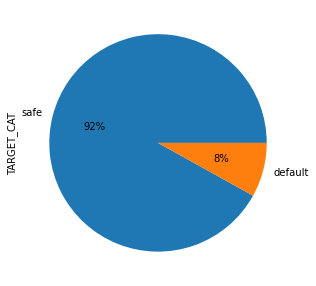

In [ ]:
# pie chart of target_cat
plt.figure(figsize=(5,5))
appl_data.TARGET_CAT.value_counts(normalize=True).plot.pie(autopct='%1.0f%%')
plt.show()

In [ ]:
# Gender distribution in data
appl_data.CODE_GENDER.value_counts(normalize = True)*100

F      65.834385
M      34.164314
XNA     0.001301
Name: CODE_GENDER, dtype: float64

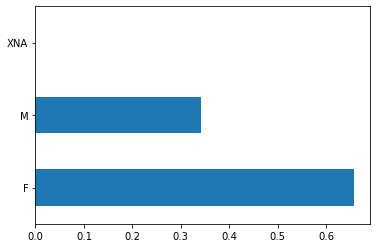

In [ ]:
#a bar graph for gender columns plot
appl_data.CODE_GENDER.value_counts(normalize = True).plot.barh()
plt.show()

##### Education distribution in data
appl_data.NAME_EDUCATION_TYPE.value_counts()

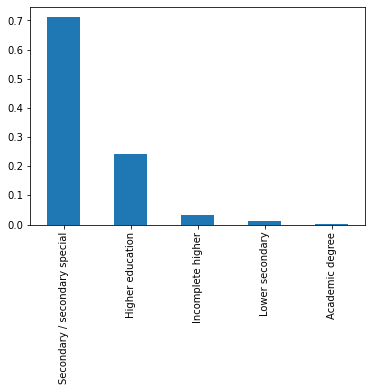

In [ ]:
# bar chart for education type
appl_data.NAME_EDUCATION_TYPE.value_counts(normalize=True).plot.bar()
plt.show()

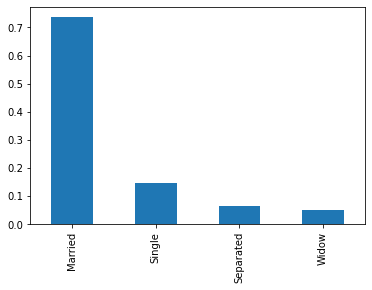

In [ ]:
# Family status
appl_data.NAME_FAMILY_STATUS.value_counts(normalize=True).plot.bar()
plt.show()

#### occupation type

In [ ]:
appl_data.OCCUPATION_TYPE.value_counts(normalize=True)*100

Laborers                 26.139534
Sales staff              15.205786
Core staff               13.059109
Managers                 10.122349
Drivers                   8.811702
High skill tech staff     5.390376
Accountants               4.647660
Medicine staff            4.043729
Security staff            3.183543
Cooking staff             2.816448
Cleaning staff            2.203991
Private service staff     1.256175
Low-skill Laborers        0.991393
Waiters/barmen staff      0.638509
Secretaries               0.618141
Realty agents             0.355727
HR staff                  0.266677
IT staff                  0.249151
Name: OCCUPATION_TYPE, dtype: float64

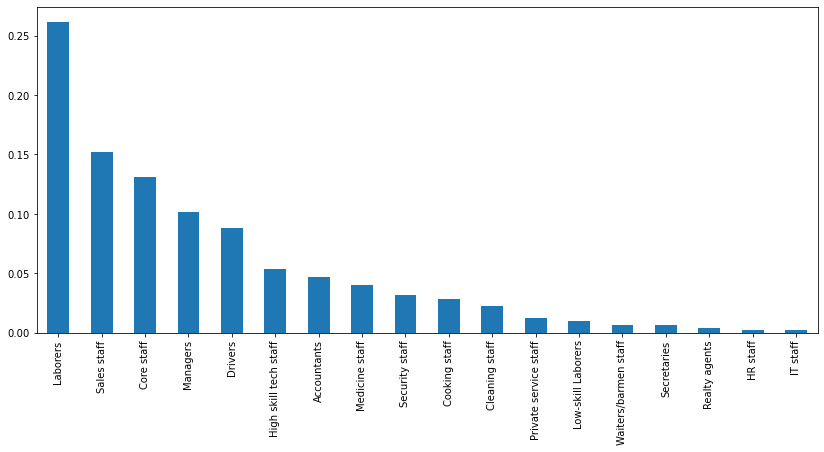

In [ ]:
plt.figure(figsize=(14,6))
appl_data[~(appl_data.OCCUPATION_TYPE == 'Others')].OCCUPATION_TYPE.value_counts(normalize=True).plot.bar()
plt.show()

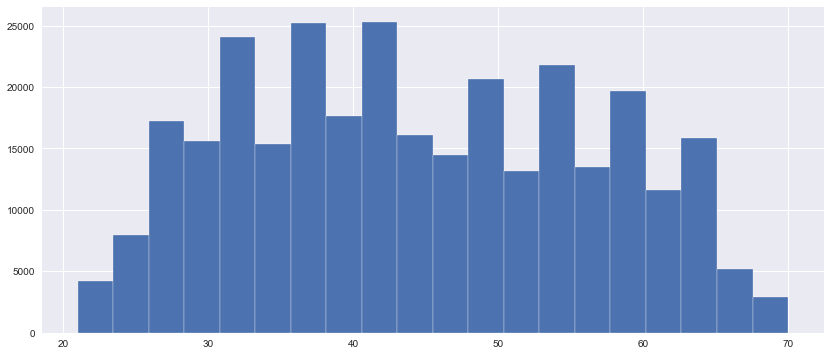

In [ ]:
plt.style.use('seaborn')
plt.figure(figsize=(14,6))
plt.hist(appl_data.AGE,bins = 20, edgecolor='White')
plt.show()

In [ ]:
# To better represent the age we can bucket age into groups
age_buckets = ['<30','30-40','40-50','50-60','60+']
appl_data['AGE_GROUP'] = pd.cut(appl_data.AGE, [0,30,40,50,60,999], labels=age_buckets)
appl_data['AGE_GROUP'].value_counts(normalize=True)*100

30-40    26.765157
40-50    24.890735
50-60    22.133408
<30      14.640595
60+      11.570105
Name: AGE_GROUP, dtype: float64

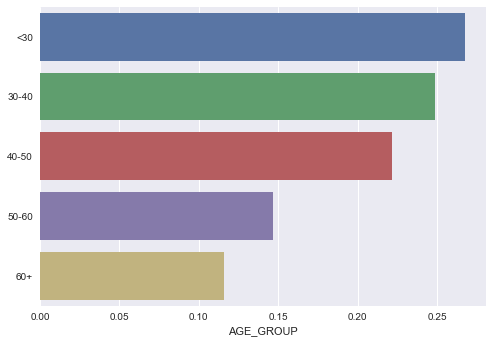

In [ ]:
#  plot a bar graph based on age buckets
sns.barplot(appl_data.AGE_GROUP.value_counts(normalize=True), age_buckets)
plt.show()

#### Previous application status

In [ ]:
appl_data.PREV_CONTRACT_STATUS.value_counts(normalize=True)*100

Approved            69.743877
Canceled            12.653655
Refused             10.769801
FirstApplication     5.350105
Unused offer         1.482563
Name: PREV_CONTRACT_STATUS, dtype: float64

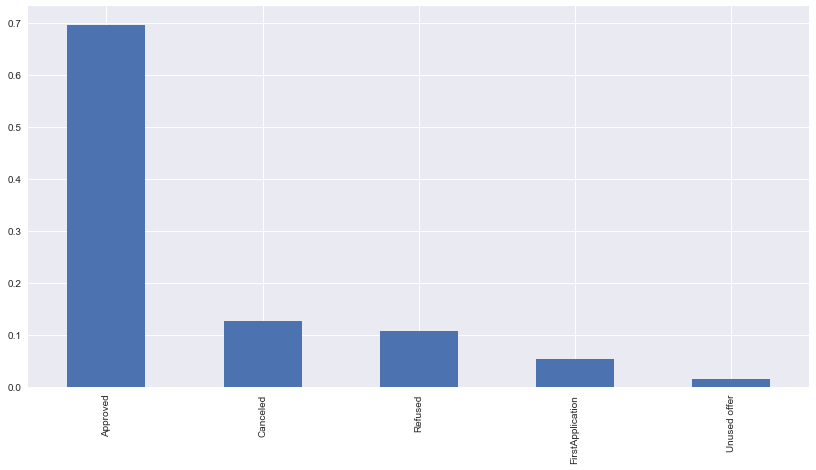

In [ ]:
# prev application status
plt.figure(figsize=(14,7))
appl_data.PREV_CONTRACT_STATUS.value_counts(normalize=True).plot.bar()
plt.show()

#### AMT_INCOME_TOTAL

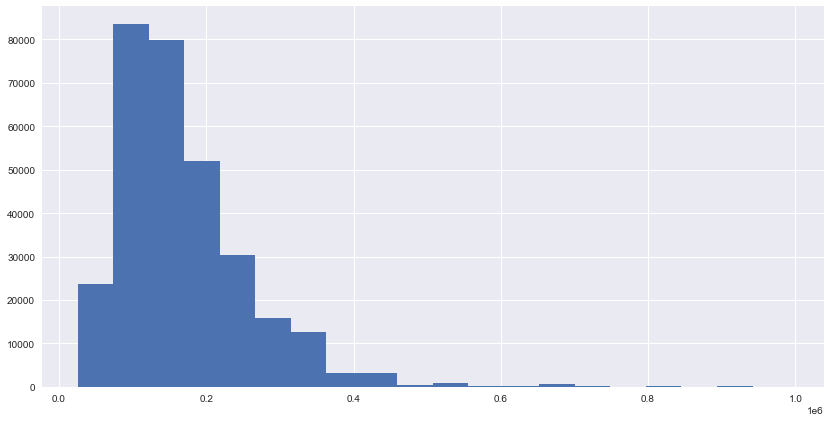

In [ ]:
plt.figure(figsize=(14,7))
plt.hist(appl_data[appl_data.AMT_INCOME_TOTAL < 10**6].AMT_INCOME_TOTAL, bins=20)
plt.show()

#### AMT_CREDIT

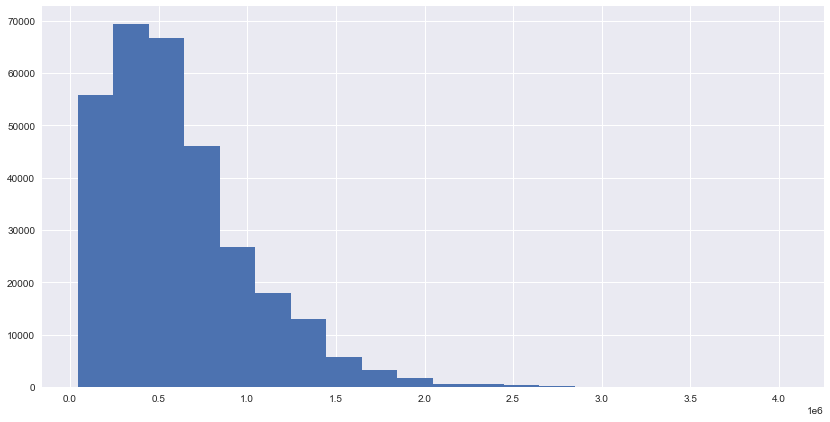

In [ ]:
plt.figure(figsize=(14,7))
plt.hist(appl_data.AMT_CREDIT, bins=20)
plt.show()

#### EXT_SOURCE_AVG

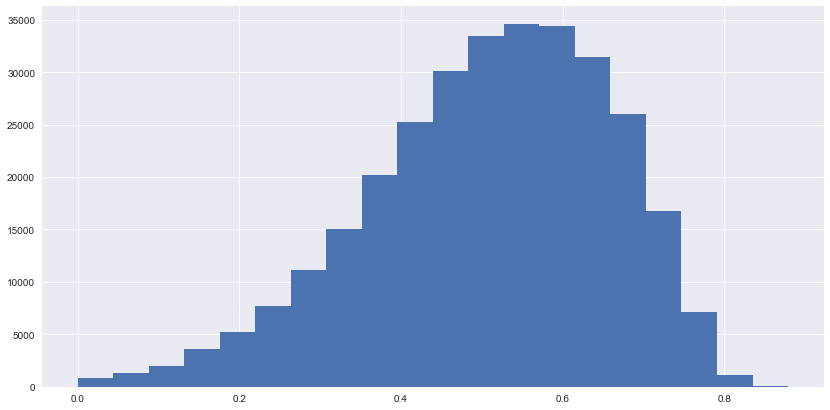

In [ ]:
plt.figure(figsize=(14,7))
plt.hist(appl_data.EXT_SOURCE, bins=20)
plt.show()

#### Owns property

In [ ]:
appl_data.FLAG_OWN_REALTY.value_counts(normalize=True)*100

Y    69.366976
N    30.633024
Name: FLAG_OWN_REALTY, dtype: float64

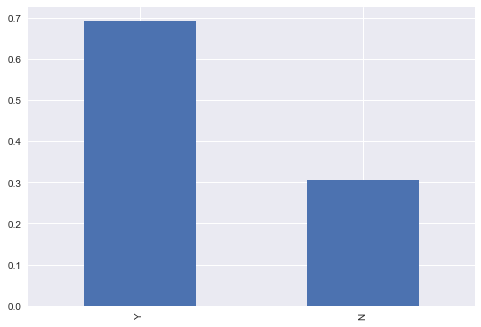

In [ ]:
# plot FLAG_OWN_REALTY
appl_data.FLAG_OWN_REALTY.value_counts(normalize=True).plot.bar()
plt.show()

# Bivariate Analysis

## Numeric - Categorical

#### Occupation type v Total Income

In [ ]:
appl_data.groupby('OCCUPATION_TYPE').AMT_INCOME_TOTAL.aggregate(['mean', 'median'])

,mean,median
OCCUPATION_TYPE,,
Accountants,194577.550499,178218.0
Cleaning staff,130790.895551,112500.0
Cooking staff,138396.508176,126000.0
Core staff,172656.695254,157500.0
Drivers,187011.606413,180000.0
HR staff,188916.282416,158400.0
High skill tech staff,182842.045683,157500.0
IT staff,213465.601711,180000.0
Laborers,164240.355724,157500.0


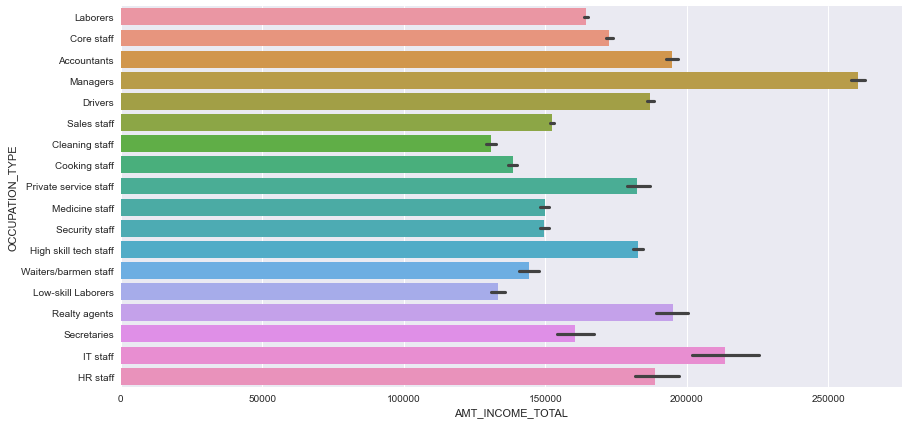

In [ ]:
plt.figure(figsize=(14,7))
sns.barplot(appl_data.AMT_INCOME_TOTAL, appl_data.OCCUPATION_TYPE)
plt.show()

#### Education level vs Income

In [ ]:
appl_data.groupby('NAME_EDUCATION_TYPE').AMT_INCOME_TOTAL.aggregate(['mean', 'median'])

,mean,median
NAME_EDUCATION_TYPE,,
Academic degree,240009.146341,211500.0
Higher education,208652.135993,180000.0
Incomplete higher,181563.812397,157500.0
Lower secondary,129995.499869,112500.0
Secondary / secondary special,154623.483787,135000.0


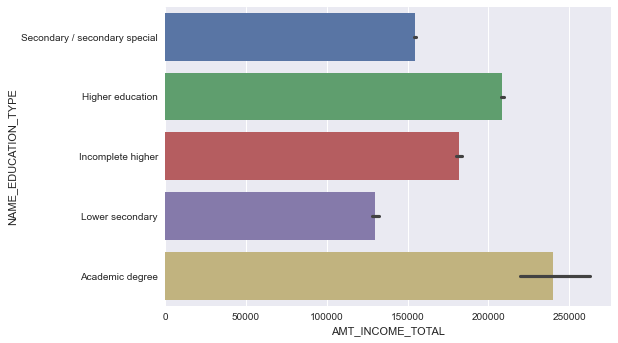

In [ ]:
# Education level vs Income
sns.barplot(appl_data.AMT_INCOME_TOTAL, appl_data.NAME_EDUCATION_TYPE)
plt.show()

#### Marital status vs Amount of Loan

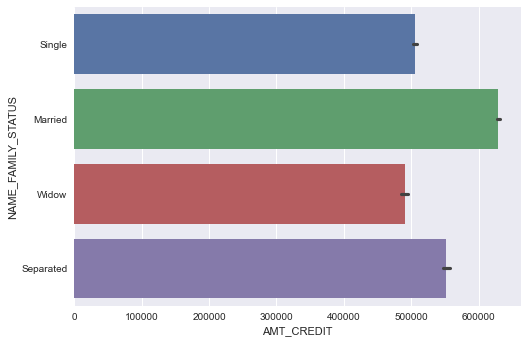

In [ ]:
# Marital Status of the applicant vs Amount requested for Loan
sns.barplot(appl_data.AMT_CREDIT, appl_data.NAME_FAMILY_STATUS)
plt.show()

#### Total no. of Credit Bureau Searches vs Status of previous Loan Application

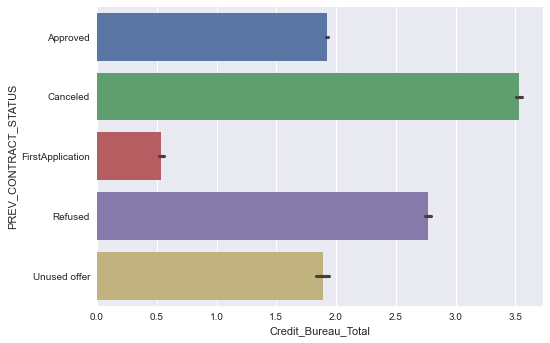

In [ ]:
sns.barplot(appl_data.Credit_Bureau_Total, appl_data.PREV_CONTRACT_STATUS)
plt.show()

#### Amount of loan vs target

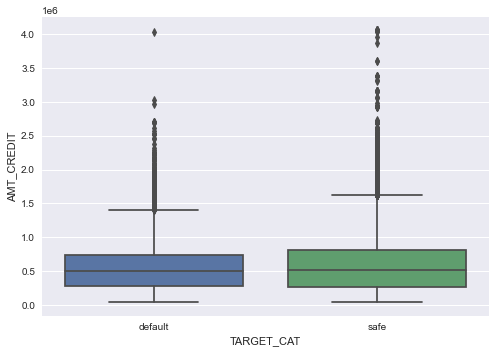

In [ ]:
sns.boxplot(x=appl_data.TARGET_CAT, y=appl_data.AMT_CREDIT)
plt.show()

#### Ext Source Score vs target

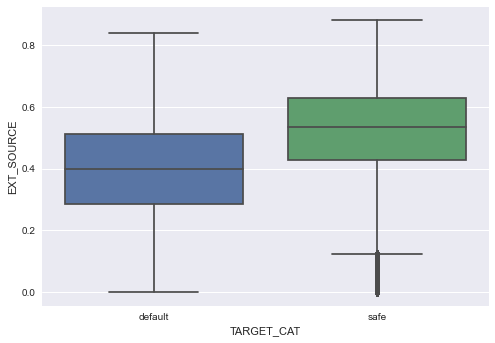

In [ ]:
sns.boxplot(x=appl_data.TARGET_CAT, y=appl_data.EXT_SOURCE)
plt.show()

#### Income Amount vs target

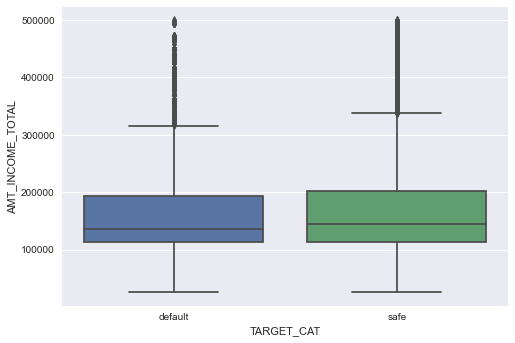

In [ ]:
sns.boxplot(x=appl_data.TARGET_CAT, y=appl_data[appl_data.AMT_INCOME_TOTAL < 0.5*10**6].AMT_INCOME_TOTAL)
plt.show()

#### Age group vs target

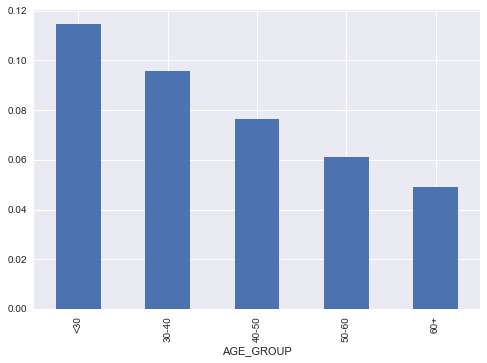

In [ ]:
appl_data.groupby('AGE_GROUP').TARGET.mean().plot.bar()
plt.show()

#### Family member count vs target

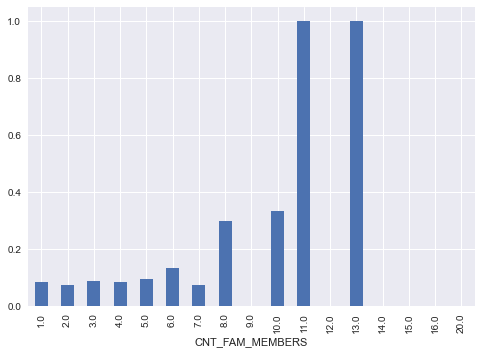

In [ ]:
appl_data.groupby('CNT_FAM_MEMBERS').TARGET.mean().plot.bar()
plt.show()

## Category - Category

#### NAME_FAMILY_STATUS vs target

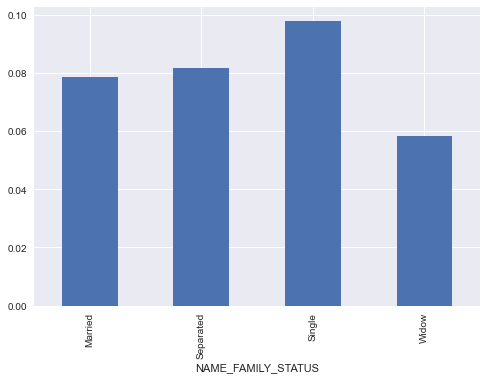

In [ ]:
appl_data.groupby('NAME_FAMILY_STATUS').TARGET.mean().plot.bar()
plt.show()

#### OCCUPATION_TYPE vs target

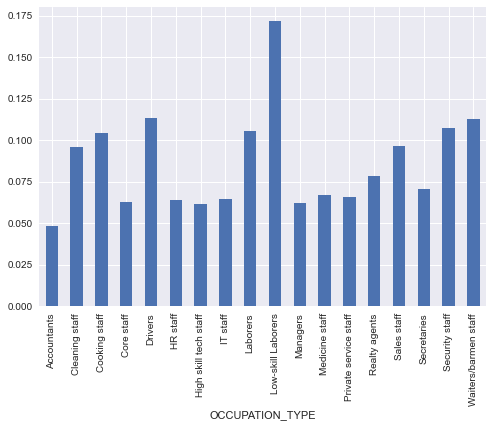

In [ ]:
appl_data.groupby('OCCUPATION_TYPE').TARGET.mean().plot.bar()
plt.show()

#### NAME_EDUCATION_TYPE vs target

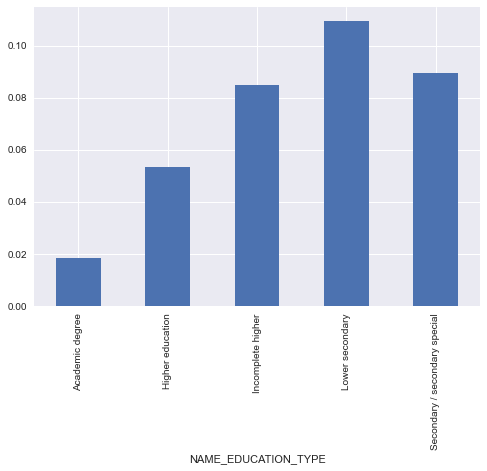

In [ ]:
appl_data.groupby('NAME_EDUCATION_TYPE').TARGET.mean().plot.bar()
plt.show()

#### PREV_CONTRACT_STATUS vs target

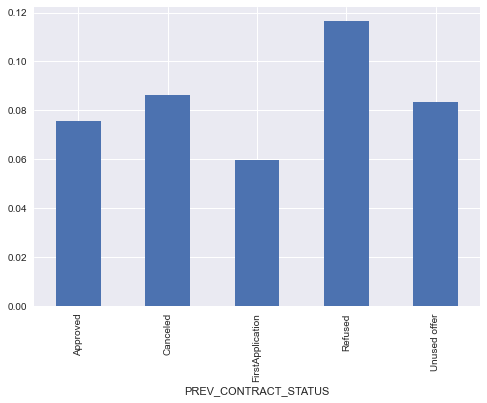

In [ ]:
appl_data.groupby('PREV_CONTRACT_STATUS').TARGET.mean().plot.bar()
plt.show()

#### PREV_REJECT_REASON vs target

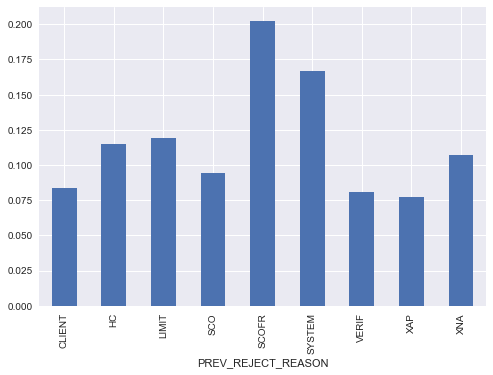

In [ ]:
appl_data.groupby('PREV_REJECT_REASON').TARGET.mean().plot.bar()
plt.show()

## Numeric - Numeric

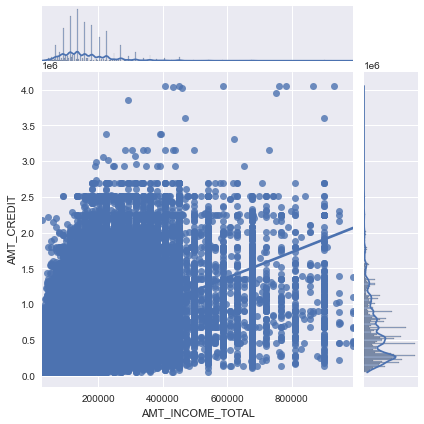

In [ ]:
#Total Income vs Amount requested for Loan
sns.jointplot(data = appl_data[appl_data.AMT_INCOME_TOTAL < 10**6], x = 'AMT_INCOME_TOTAL', y = 'AMT_CREDIT', kind='reg')
plt.show()

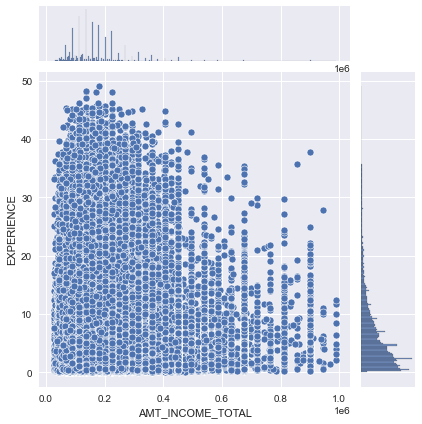

In [ ]:
#Total Income vs Experience in Years
sns.jointplot(data = appl_data[appl_data.AMT_INCOME_TOTAL < 10**6], x = 'AMT_INCOME_TOTAL', y = 'EXPERIENCE')
plt.show()

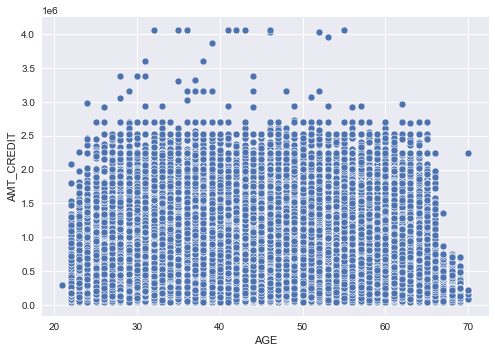

In [ ]:
#Age vs Requested Loan Amount
sns.scatterplot(appl_data.AGE, appl_data.AMT_CREDIT)
plt.show()

## Multivariate analysis

#### NAME_FAMILY_STATUS vs OCCUPATION_TYPE vs TARGET

In [ ]:
res = pd.pivot_table(data=appl_data, index='OCCUPATION_TYPE', columns='NAME_FAMILY_STATUS', values='TARGET')
res

NAME_FAMILY_STATUS,Married,Separated,Single,Widow
OCCUPATION_TYPE,,,,
Accountants,0.045846,0.053352,0.058704,0.044521
Cleaning staff,0.097342,0.078652,0.122066,0.067265
Cooking staff,0.101545,0.084135,0.144550,0.059859
Core staff,0.060456,0.057576,0.080491,0.038880
Drivers,0.106101,0.145655,0.147986,0.153153
HR staff,0.056511,0.065217,0.066667,0.200000
High skill tech staff,0.059609,0.061252,0.072008,0.048327
IT staff,0.072674,0.000000,0.060000,0.000000
Laborers,0.101180,0.109462,0.132301,0.069250


In [ ]:
appl_data.TARGET.value_counts(normalize=True)

0    0.919274
1    0.080726
Name: TARGET, dtype: float64

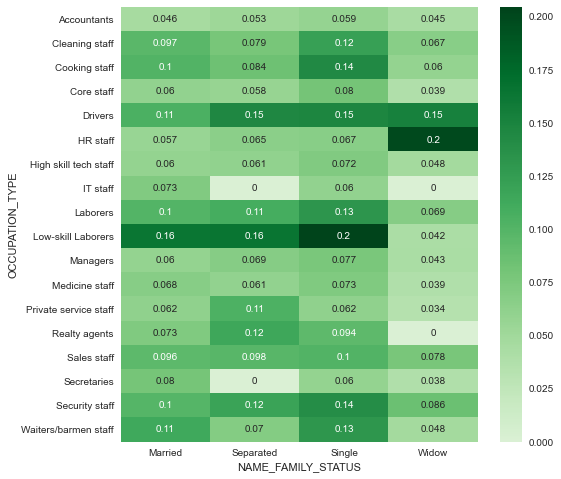

In [ ]:
plt.figure(figsize=(8,8))
sns.heatmap(res, annot=True, cmap='Greens', center=0.081)
plt.show()

#### NAME_FAMILY_STATUS vs NAME_EDUCATION_TYPE vs TARGET

In [ ]:
res = pd.pivot_table(data=appl_data, index='NAME_EDUCATION_TYPE', columns='NAME_FAMILY_STATUS', values='TARGET')
res

NAME_FAMILY_STATUS,Married,Separated,Single,Widow
NAME_EDUCATION_TYPE,,,,
Academic degree,0.017544,0.000000,0.034483,0.000000
Higher education,0.051481,0.057346,0.062049,0.048094
Incomplete higher,0.081425,0.086643,0.094143,0.063584
Lower secondary,0.108170,0.138249,0.132988,0.067961
Secondary / secondary special,0.087434,0.089904,0.113243,0.059666


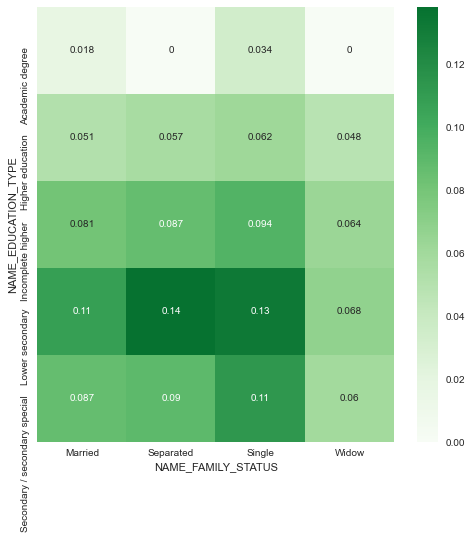

In [ ]:
plt.figure(figsize=(8,8))
sns.heatmap(res, annot=True, cmap='Greens', center=0.081)
plt.show()

#### OCCUPATION_TYPE vs	NAME_EDUCATION_TYPE vs TARGET

In [ ]:
res = pd.pivot_table(data=appl_data, index='OCCUPATION_TYPE', columns='NAME_EDUCATION_TYPE', values='TARGET')
res

NAME_EDUCATION_TYPE,Academic degree,Higher education,Incomplete higher,Lower secondary,Secondary / secondary special
OCCUPATION_TYPE,,,,,
Accountants,0.125000,0.038813,0.056180,0.166667,0.062077
Cleaning staff,0.000000,0.084000,0.102041,0.138889,0.095664
Cooking staff,0.000000,0.088993,0.093220,0.171875,0.105135
Core staff,0.000000,0.045670,0.083902,0.105691,0.078621
Drivers,0.000000,0.083415,0.103870,0.128514,0.117219
HR staff,NaN,0.044818,0.083333,NaN,0.100000
High skill tech staff,0.000000,0.047261,0.070085,0.129032,0.071405
IT staff,NaN,0.049853,0.038462,0.000000,0.113636
Laborers,0.000000,0.076011,0.086326,0.160274,0.109829


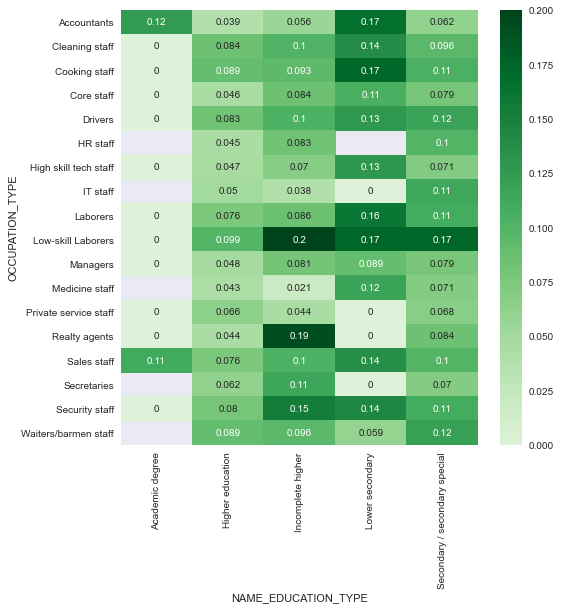

In [ ]:
plt.figure(figsize=(8,8))
sns.heatmap(res, annot=True, cmap='Greens', center=0.081)
plt.show()

#### Correlation between target, and prominent numeric variables

In [ ]:
res = appl_data[['TARGET', 'AGE', 'AMT_INCOME_TOTAL','AMT_CREDIT', 'EXT_SOURCE', 'CNT_FAM_MEMBERS', 'Credit_Bureau_Total']].corr()
res

,TARGET,AGE,AMT_INCOME_TOTAL,AMT_CREDIT,EXT_SOURCE,CNT_FAM_MEMBERS,Credit_Bureau_Total
TARGET,1.000000,-0.078232,-0.020457,-0.030369,-0.222036,0.009298,-0.002985
AGE,-0.078232,1.000000,-0.056616,0.055392,0.279730,-0.278894,0.069799
AMT_INCOME_TOTAL,-0.020457,-0.056616,1.000000,0.342172,0.082098,0.032363,0.065497
AMT_CREDIT,-0.030369,0.055392,0.342172,1.000000,0.143684,0.063160,0.006282
EXT_SOURCE,-0.222036,0.279730,0.082098,0.143684,1.000000,-0.037363,-0.003752
CNT_FAM_MEMBERS,0.009298,-0.278894,0.032363,0.063160,-0.037363,1.000000,-0.013251
Credit_Bureau_Total,-0.002985,0.069799,0.065497,0.006282,-0.003752,-0.013251,1.000000


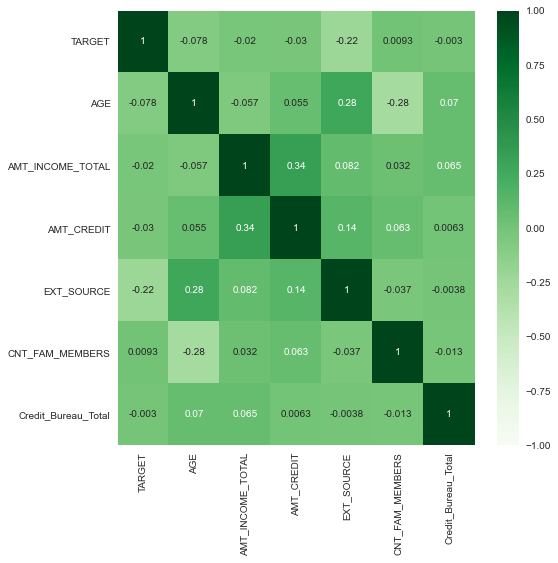

In [ ]:
plt.figure(figsize=(8,8))
sns.heatmap(res, annot=True, cmap='Greens', vmin=-1,vmax=1)
plt.show()